------
<h1>
    <center>
        Sentinel-2A Image Processing <br><br>Extraction of Texture Features using Grey-Level Co-occurrence Matrix<br>
    </center>
</h1>

------


The notebook presents the implementation steps.

## ToDO List Overview

Performing Grey-Level Co-occurrence Matrix (GLCM) texture-based analysis on multi-spectral index satellite images can help capture urban morphological characteristics of a region. GLCM is a method used in image processing to extract second-order statistical texture features from images. Here’s how to approach this task:

1. **Data Preparation:**
    * Satellite Image Acquisition: Obtain the multi-spectral index satellite images for the region of interest.
    * Preprocessing: Perform necessary preprocessing steps such as atmospheric correction, geometric correction, and radiometric correction.
    * Index Calculation: Calculate relevant indices (e.g., NDVI, NDBI, etc.) if they are not already available.<br><br>

3. **GLCM Texture Analysis:**
    * Import Libraries: Use Python libraries like rasterio for handling raster data and skimage for computing GLCM and extracting texture features.<br><br>

5. **Calculate GLCM:**
    * Compute the GLCM for the images.
    * Extract Texture Features: Extract texture features such as contrast, dissimilarity, homogeneity, energy, and correlation from the GLCM.<br><br>

7. **Implementation Steps:**

   * Here is a step-by-step guide with sample code

## Imports of Required Packages and Setup

In [1]:
import os
import sys
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point

from skimage import exposure
import rioxarray as riox
import rasterio as rio
from rasterio.plot import show

sys.path.insert(0, "../scripts")
import utils as s2u
import spectral_indix_tools as spt

## Dataset Overview

### About Informal Settlement Dataset

The Informal Settlement Dataset is Urban Malaria Project (UMP) and was given access to in April, 2024. The dataset contains some "ground-validated" locations of informal population settlements across some selected wards from local government administratives of Ibadan, Illorin and Kano cities in Nigeria. Through visual interpretation, we want to generate ground-truth polygons of the informal settlements. This will will result in converting vector shapefiles to raster masks and thus generating the training dataframe.

### About Sentinel-2 Imagery

SENTINEL-2 is a wide-swath, high-resolution, multi-spectral imaging mission, supporting Copernicus Land Monitoring studies, including the monitoring of vegetation, soil and water cover, as well as observations of inland waterways and coastal areas ([Source](https://sentinel.esa.int/web/sentinel/user-guides/sentinel-2-msi/overview)). 

**Note**: We are looking for 2022-09-01 – 2023-01-31 satellite imagery from L-2A Sentinel-2 Imagery, hence, Sentinel-2A. 

## Load and process rasters

In [2]:
### Load and read rraster 
filename = "../../../S2/Ibadan-shp_geojs/S2_ibadan_2022-09-01_2022-12-31_file3.tif"
raster, img, img_enhanced = s2u.get_s2_processed_l1(filename)

In [3]:
raster.meta

{'driver': 'GTiff',
 'dtype': 'float32',
 'nodata': None,
 'width': 2779,
 'height': 2148,
 'count': 11,
 'crs': CRS.from_epsg(4326),
 'transform': Affine(8.983152841195215e-05, 0.0, 3.761785083778908,
        0.0, -8.983152841195215e-05, 7.498058013488822)}

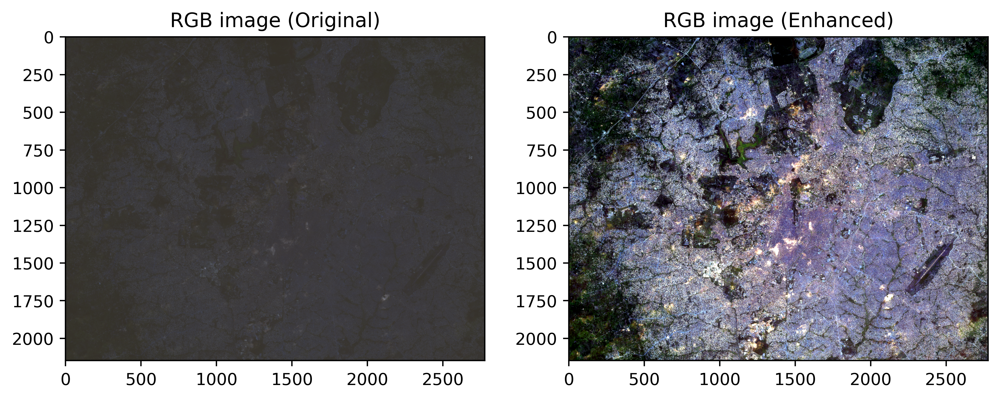

In [5]:
### Plot imagery
fig,(ax1, ax2)= plt.subplots(1, 2, figsize=(10,5), dpi=500)
ax1.set_title("RGB image (Original)")
ax2.set_title("RGB image (Enhanced)")
ax1.imshow(img[:, :, 0:3])
ax2.imshow(img_enhanced[:, :, 0:3])
plt.show();

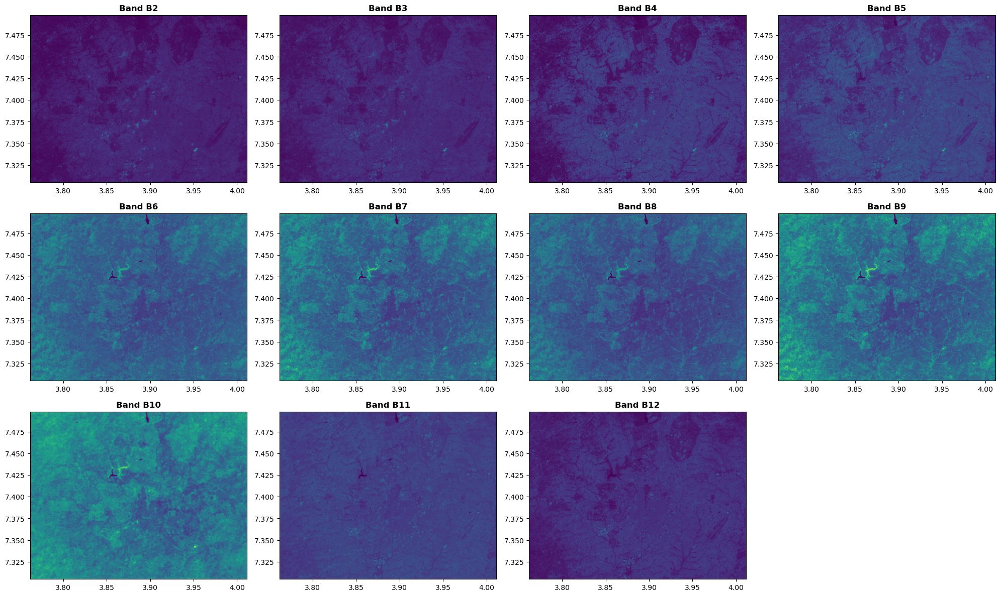

In [13]:
fig, ax = plt.subplots(3, 4, figsize=(20, 12))
ax = ax.reshape(-1)
for idx in range(11):
    show((raster, idx+1), ax=ax[idx], title=f'Band B{idx+2}')
ax[-1].set_axis_off()
fig.tight_layout();

In [4]:
### Load and read rraster 
filename = "../../../LandSat9/landsat2_SR_bands.tif"
raster, img, img_enhanced = s2u.get_s2_processed_l1(filename)

In [5]:
raster.meta

{'driver': 'GTiff',
 'dtype': 'float64',
 'nodata': None,
 'width': 2477,
 'height': 2147,
 'count': 19,
 'crs': CRS.from_epsg(4326),
 'transform': Affine(0.00026949458523585647, 0.0, 3.612844409671892,
        0.0, -0.00026949458523585647, 7.639093513095587)}

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


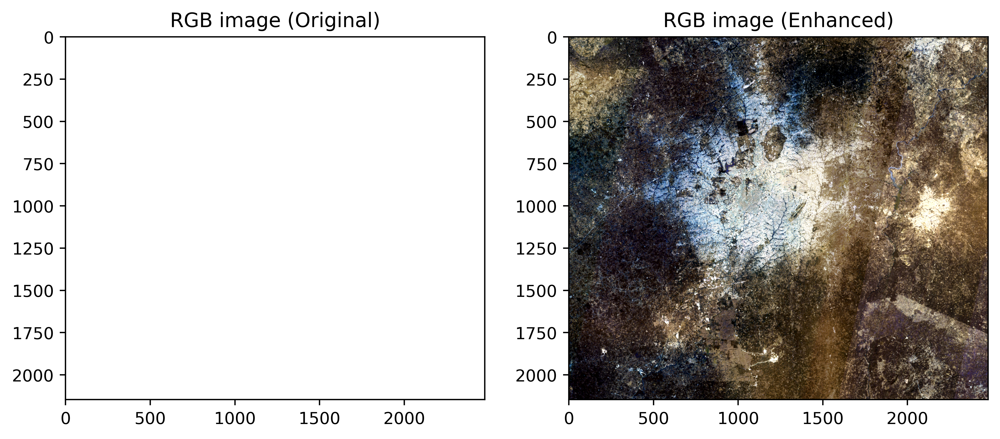

In [6]:
### Plot imagery
fig,(ax1, ax2)= plt.subplots(1, 2, figsize=(10,5), dpi=500)
ax1.set_title("RGB image (Original)")
ax2.set_title("RGB image (Enhanced)")
ax1.imshow(img[:, :, 0:3])
ax2.imshow(img_enhanced[:, :, 0:3])
plt.show();

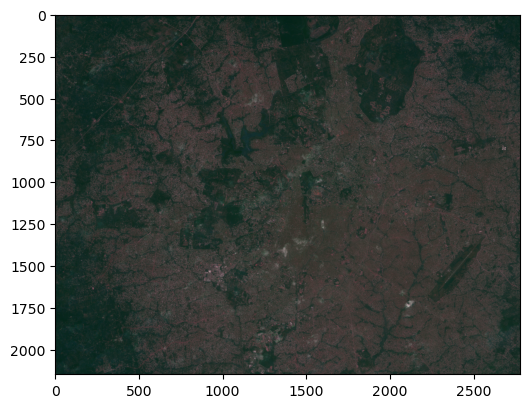

In [4]:
filename = "../../../S2/Ibadan-shp_geojs/S2_ibadan_2022-09-01_2022-12-31_file3.tif"
s2u.plot_msi_image(filename=filename, band_list = [2, 0, 1])

## Calculate spectral indices

### Load bands and calculate indices

In [4]:
filename = "../../../S2/Ibadan-shp_geojs/S2_ibadan_2022-09-01_2022-12-31_file3.tif"
Ibadan_SIs, RGB = spt.calc_spectral_indices(input_file=filename, verbose=True)

   Spectral Indices from raster image ID: S2_ibadan_2022-09-01_2022-12-31_file3


### Visualized calculated indices

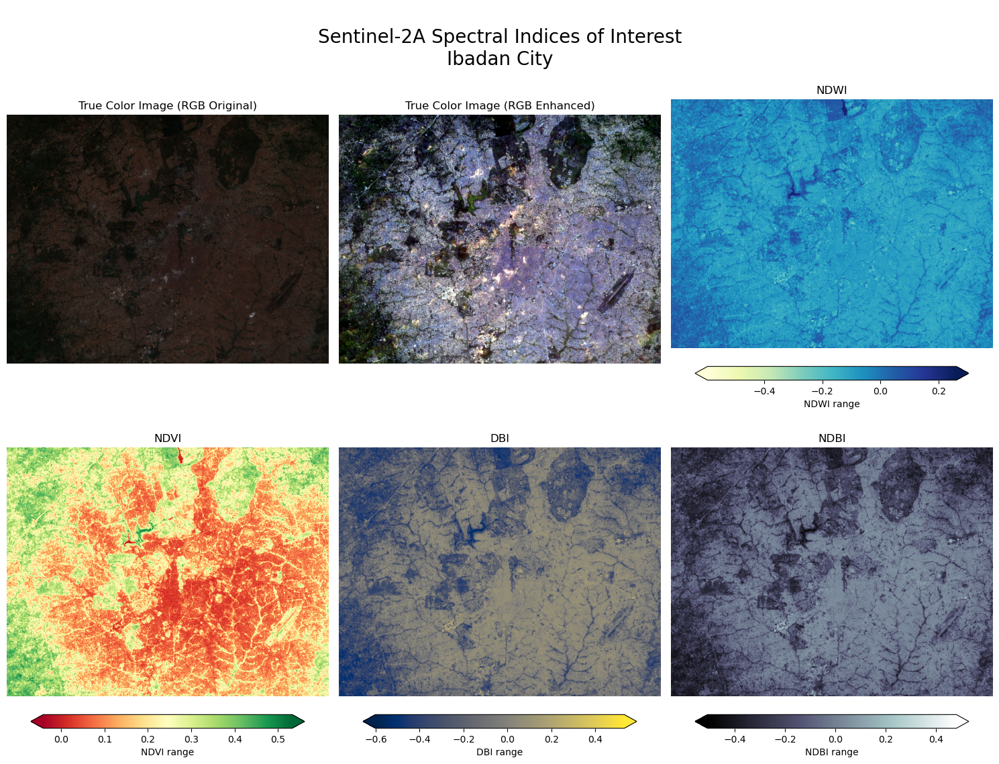

In [5]:
fig = s2u.plot_spectral_indices(input_file=filename)

## Create tiles from original raster

In [4]:
from geotile import GeoTile

In [5]:
filename = "../../../S2/Ibadan-shp_geojs/S2_ibadan_2022-09-01_2022-12-31_file3.tif"
raster = rio.open(filename)
gt_ibadan = GeoTile(filename)
gt_ibadan.meta

{'driver': 'GTiff',
 'dtype': 'float32',
 'nodata': None,
 'width': 2779,
 'height': 2148,
 'count': 11,
 'crs': CRS.from_epsg(4326),
 'transform': Affine(8.983152841195215e-05, 0.0, 3.761785083778908,
        0.0, -8.983152841195215e-05, 7.498058013488822)}

In [6]:
raster.meta

{'driver': 'GTiff',
 'dtype': 'float32',
 'nodata': None,
 'width': 2779,
 'height': 2148,
 'count': 11,
 'crs': CRS.from_epsg(4326),
 'transform': Affine(8.983152841195215e-05, 0.0, 3.761785083778908,
        0.0, -8.983152841195215e-05, 7.498058013488822)}

In [7]:
### Generate aand save the tiles
out_dir = "../../../S2/Ibadan-shp_geojs/geotiles/"
gt_ibadan.generate_tiles(save_tiles=False, save_transform=True, tile_x=256, tile_y=256, stride_x=256, stride_y=256)
gt_ibadan.convert_nan_to_zero()
gt_ibadan.drop_nan_tiles()
gt_ibadan.drop_zero_value_tiles()
# gt_ibadan.save_tiles(output_folder=out_dir, suffix="s2ib_f4")
gt_ibadan.meta

{'driver': 'GTiff',
 'dtype': 'float32',
 'nodata': None,
 'width': 2779,
 'height': 2148,
 'count': 11,
 'crs': CRS.from_epsg(4326),
 'transform': Affine(8.983152841195215e-05, 0.0, 3.761785083778908,
        0.0, -8.983152841195215e-05, 7.498058013488822)}

In [8]:
geo_data = gt_ibadan.tile_data
print(geo_data.shape)
### Change the axis from (band, x, y) to (x, y, band)
# geo_data = np.transpose(geo_data, (1, 2, 0))
print(geo_data.shape)

(99, 256, 256, 11)
(99, 256, 256, 11)


In [9]:
### Process Geo-raster 
geo_data, geo_enhanced = s2u.geo_enhance_s2_rgb(geo_data)

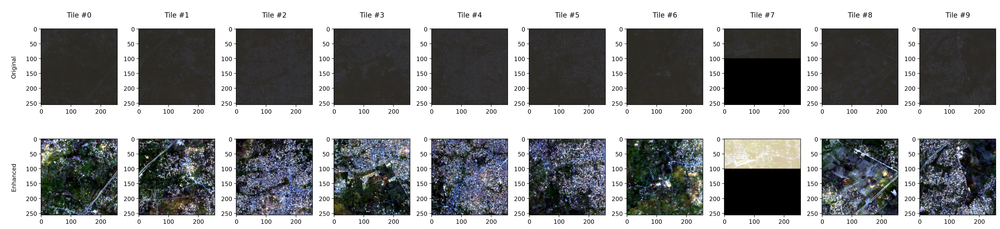

In [21]:
### Plot imagery
fig, ax = plt.subplots(2, 10, figsize=(24,6), dpi=200)

# fig.suptitle("\nRGB tiles", y=0.95)
ax[0,0].set_ylabel("\nOriginal\n")
ax[1,0].set_ylabel("\nEnhanced\n")
for j in range(10):
    ax[0, j].imshow(geo_data[j+10, :, :, 0:3], cmap="terrain")
    ax[1, j].imshow(geo_enhanced[j+10, :, :, 0:3], cmap="terrain")
    ax[0, j].set_title(f"\nTile #{j}\n")
    
fig.tight_layout();